[INFO] Indexades 574 imatges de la BBDD.
[INFO] Trobades 30 queries a descriptor/qsd1_w1

=== QUERY: 00000.jpg ===


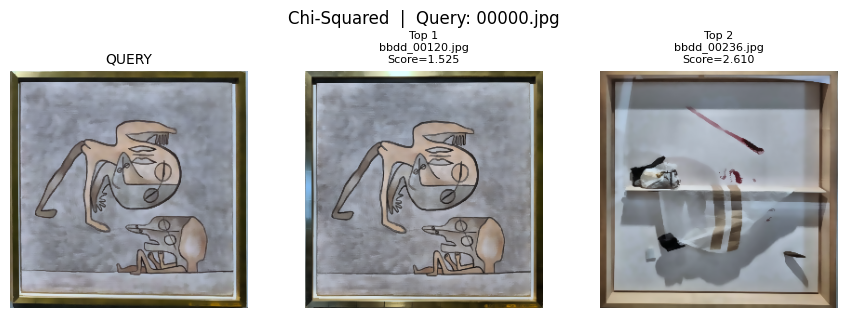

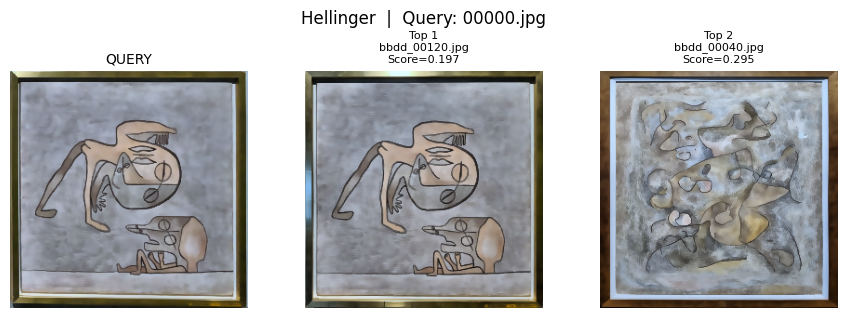


=== QUERY: 00001.jpg ===


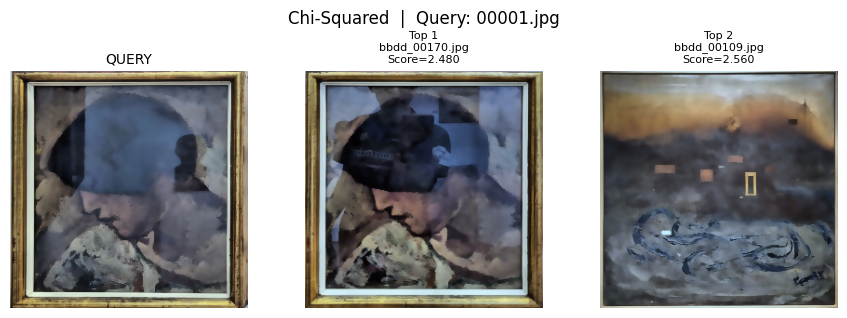

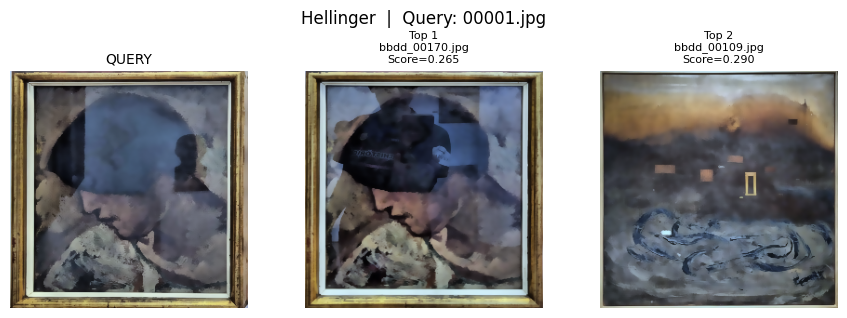


=== QUERY: 00002.jpg ===


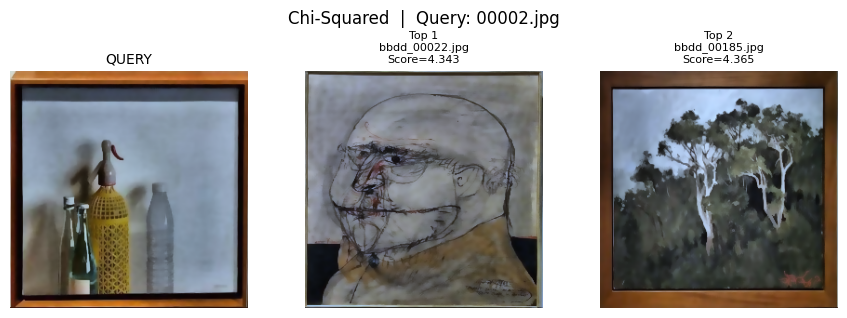

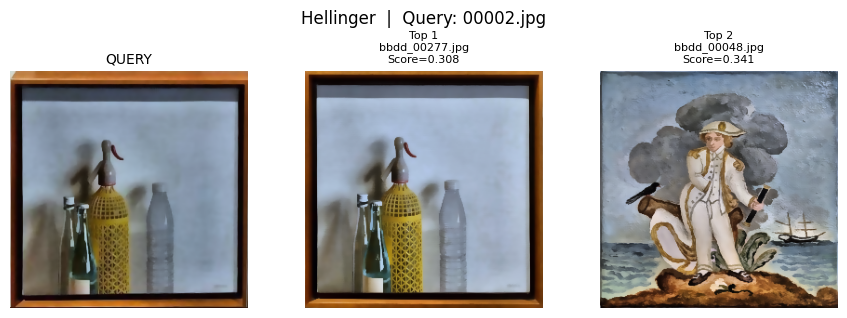


=== QUERY: 00003.jpg ===


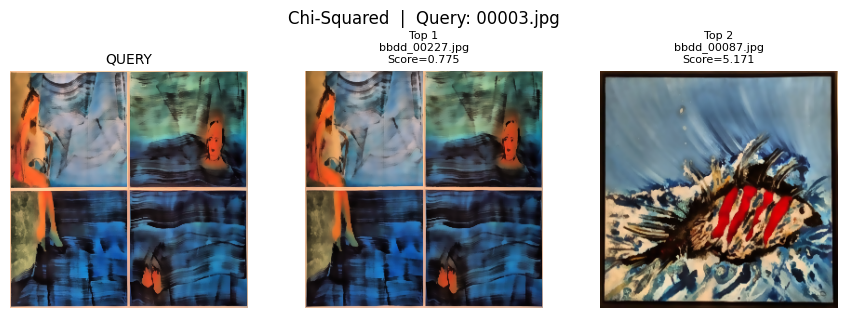

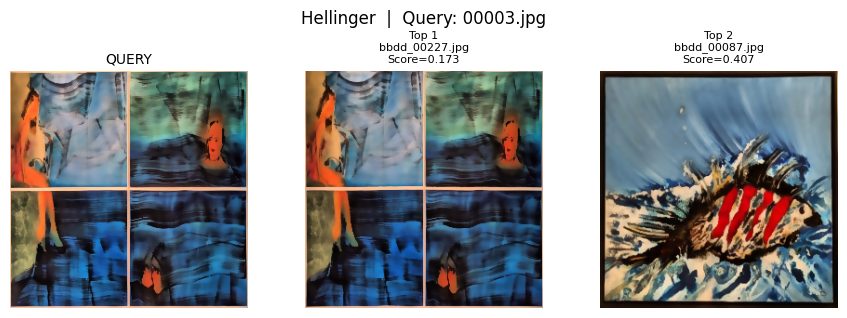


=== QUERY: 00004.jpg ===


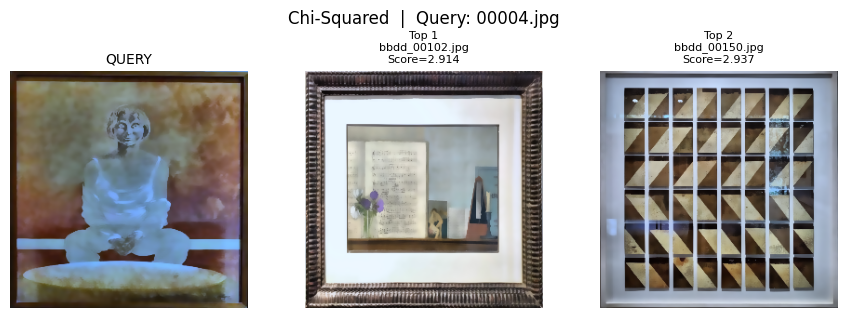

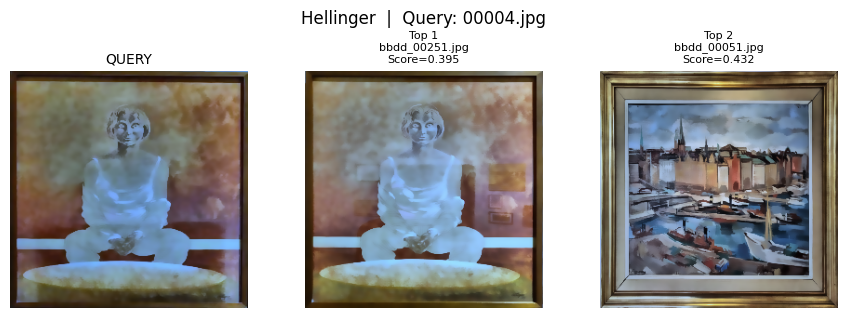


=== QUERY: 00005.jpg ===


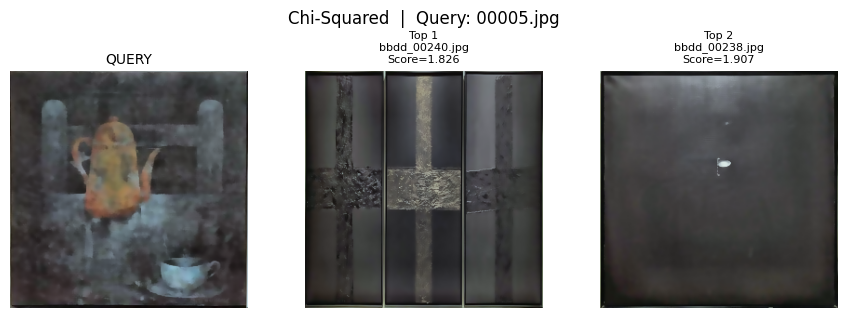

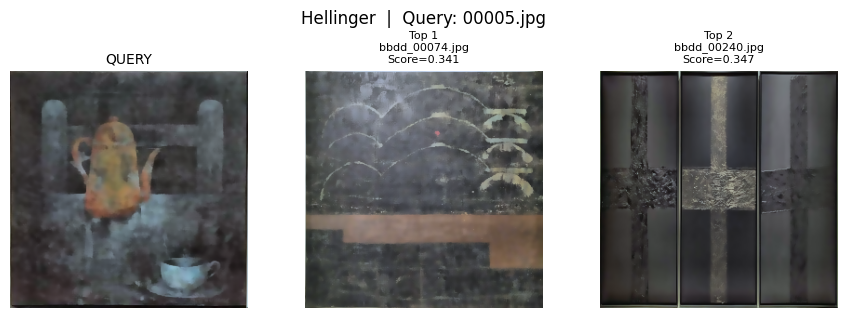


=== QUERY: 00006.jpg ===


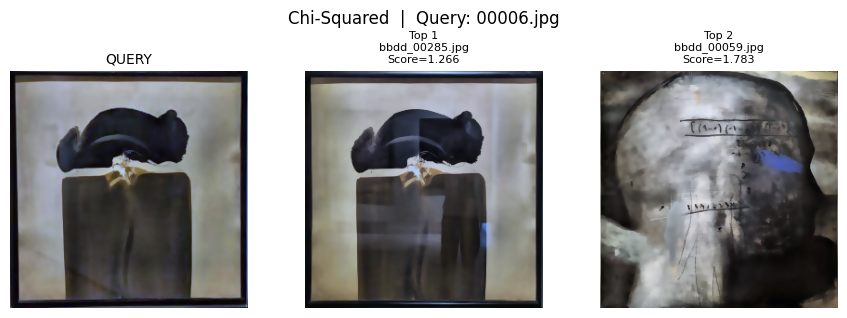

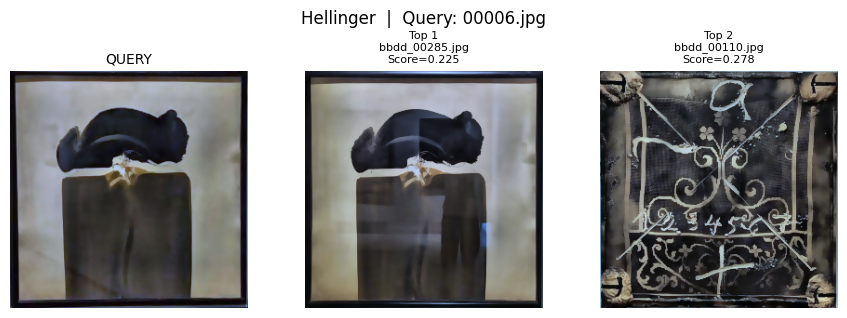


=== QUERY: 00007.jpg ===


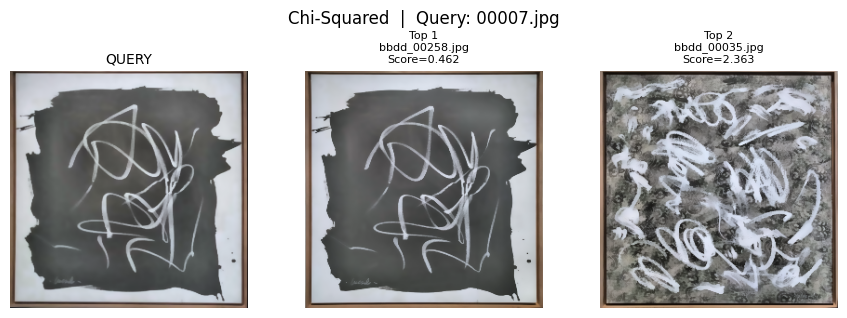

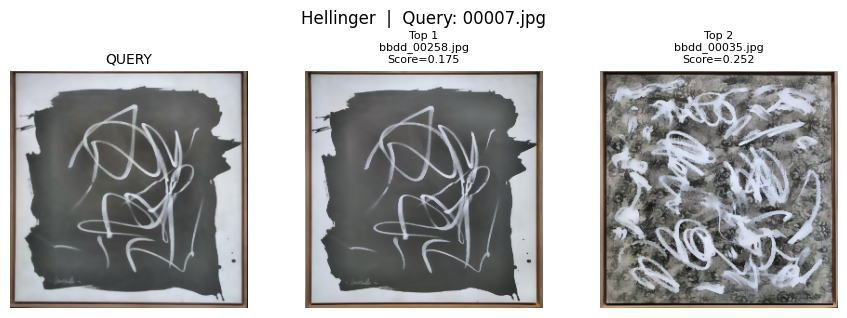


=== QUERY: 00008.jpg ===


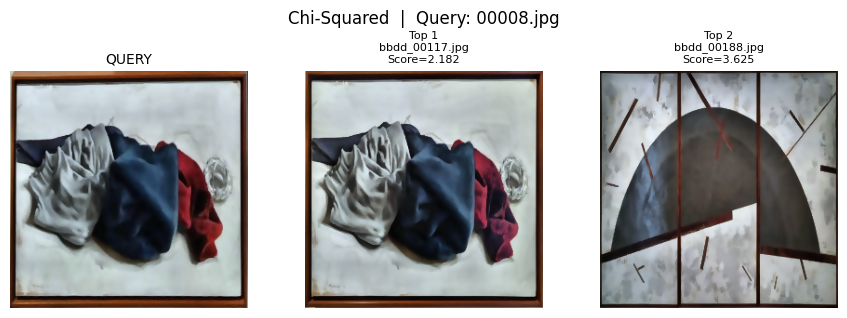

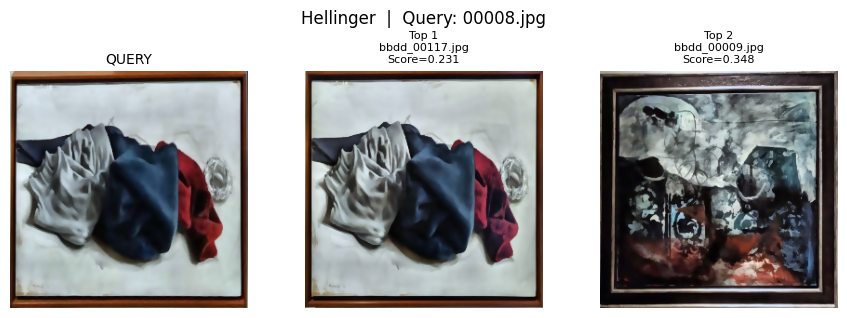


=== QUERY: 00009.jpg ===


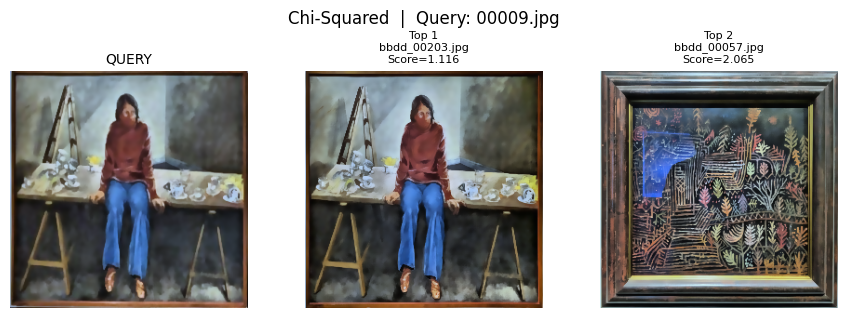

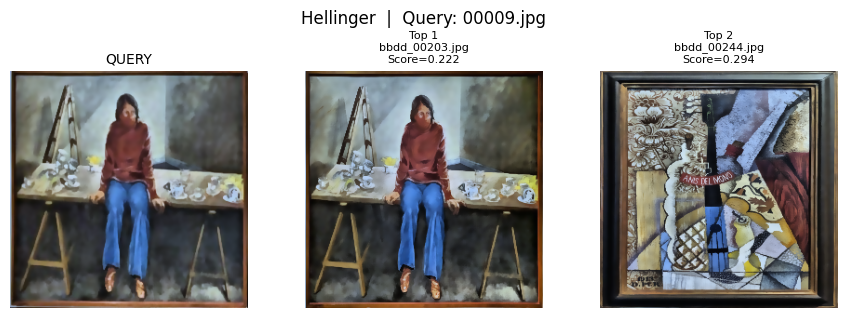


=== QUERY: 00010.jpg ===


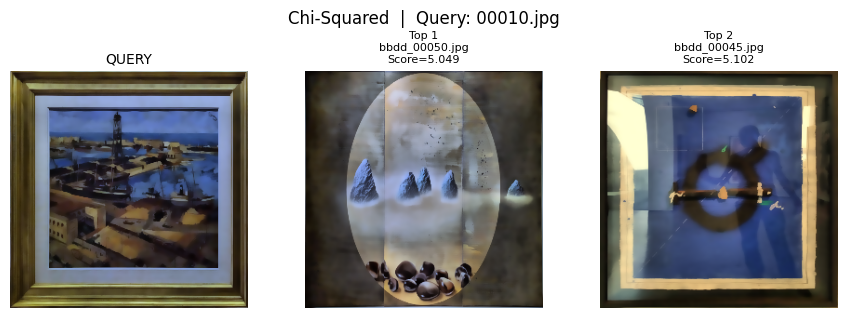

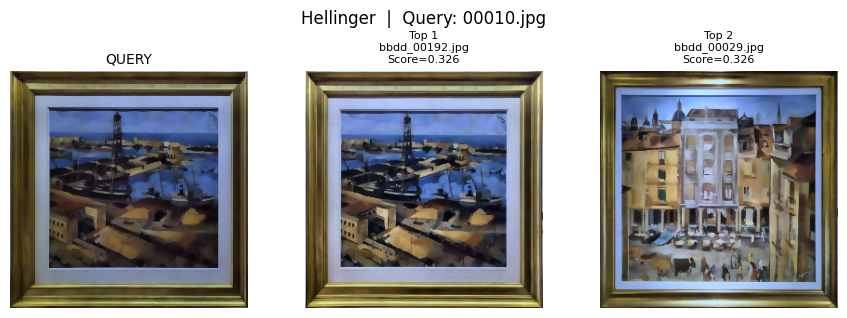


=== QUERY: 00011.jpg ===


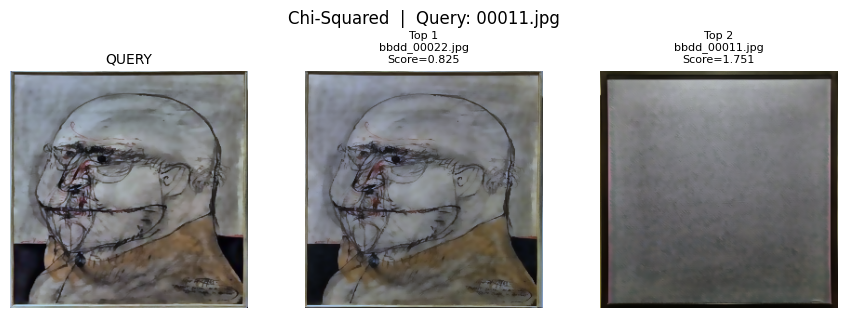

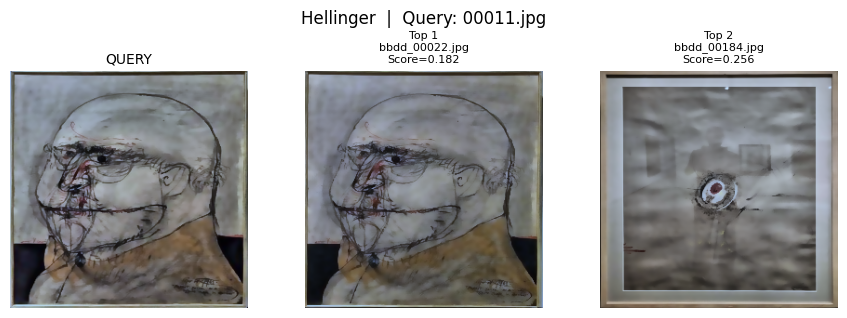


=== QUERY: 00012.jpg ===


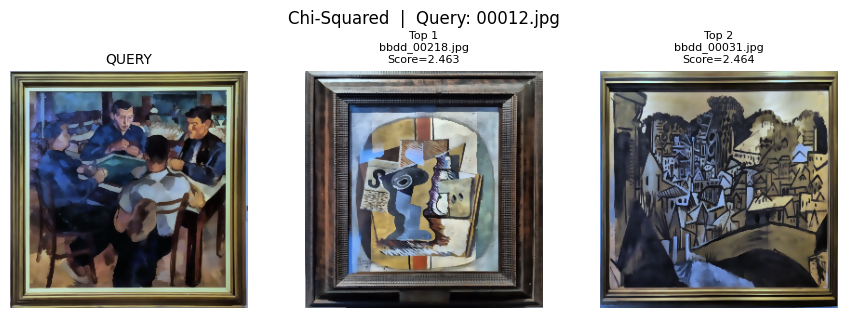

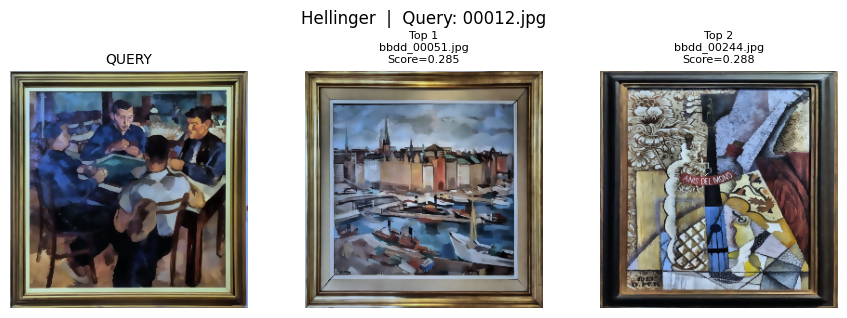


=== QUERY: 00013.jpg ===


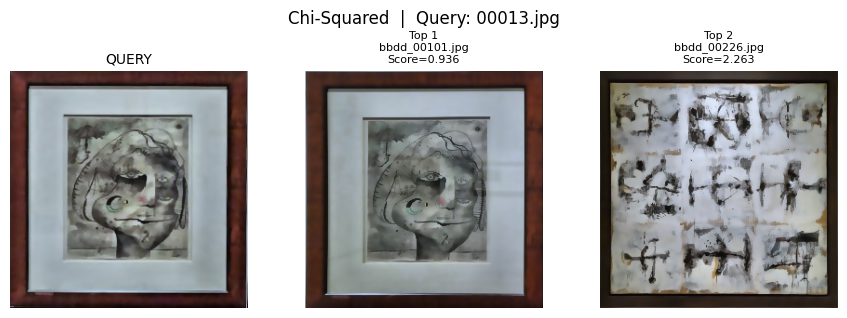

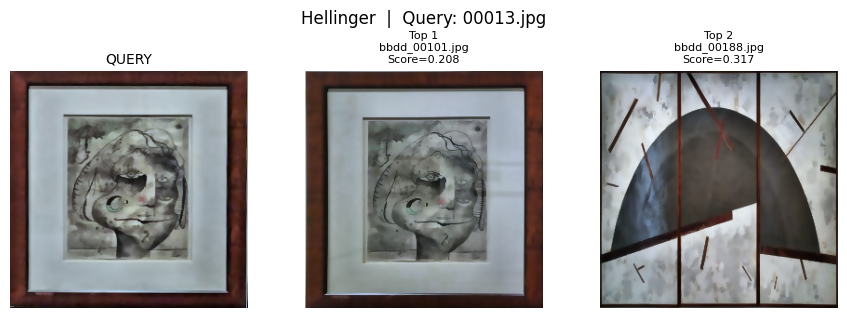


=== QUERY: 00014.jpg ===


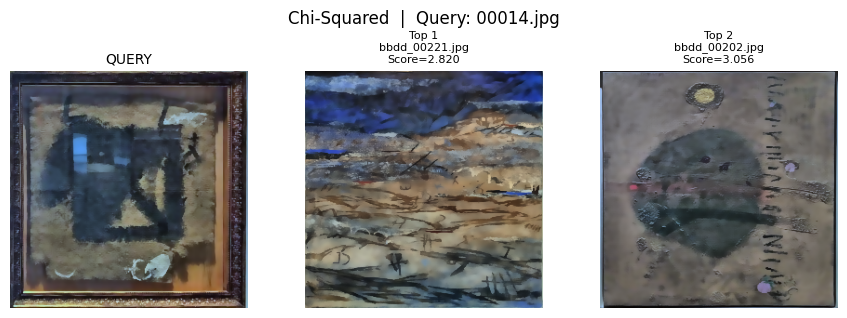

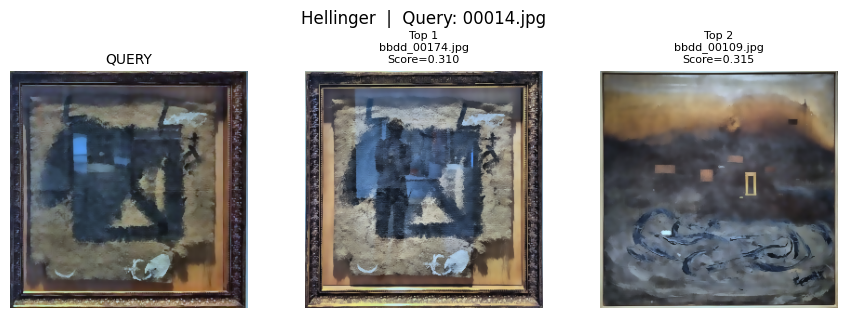


=== QUERY: 00015.jpg ===


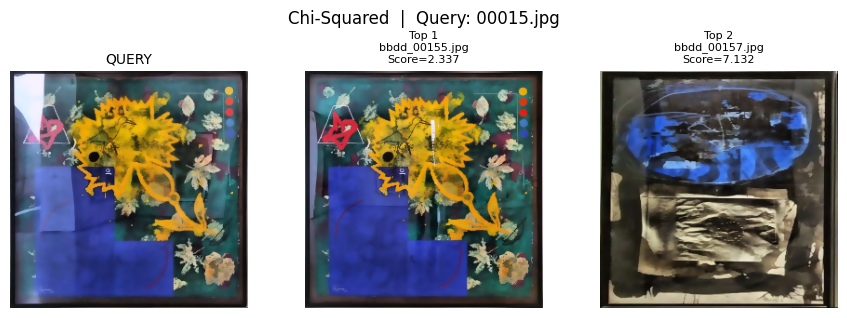

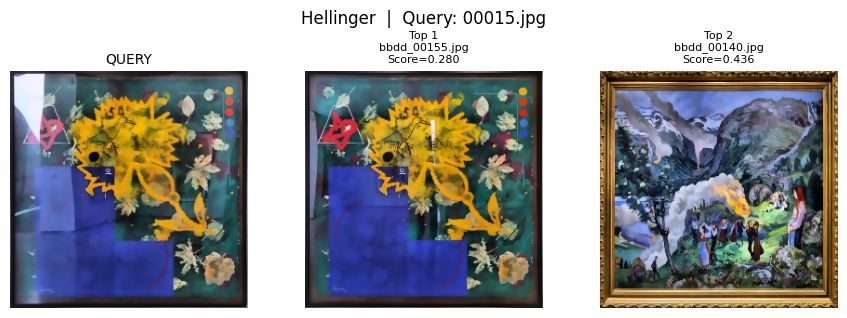


=== QUERY: 00016.jpg ===


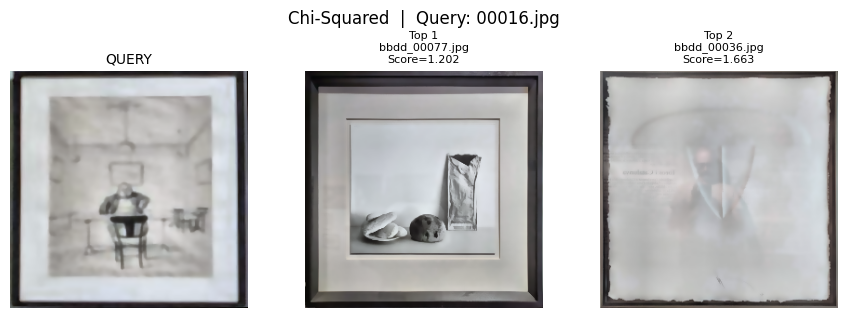

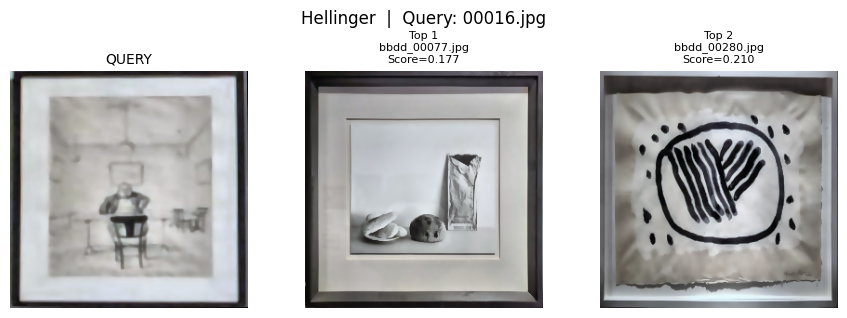


=== QUERY: 00017.jpg ===


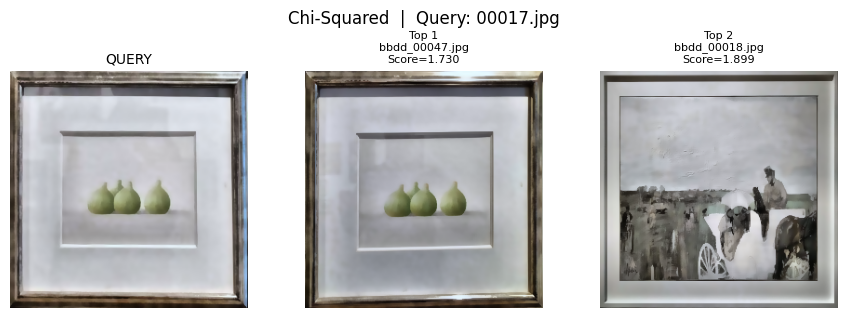

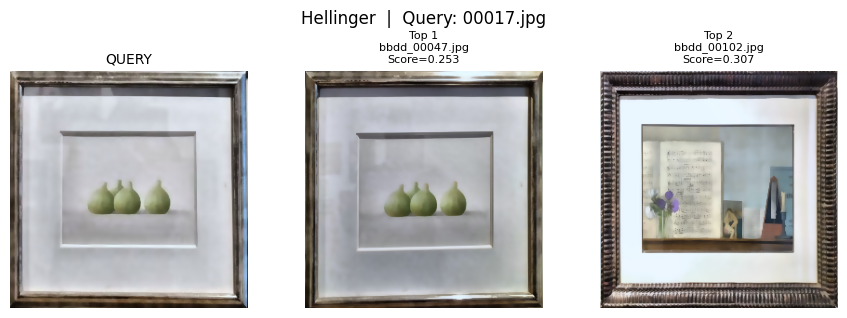


=== QUERY: 00018.jpg ===


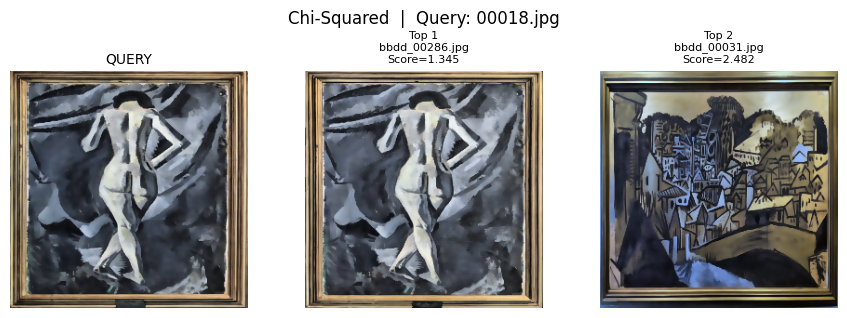

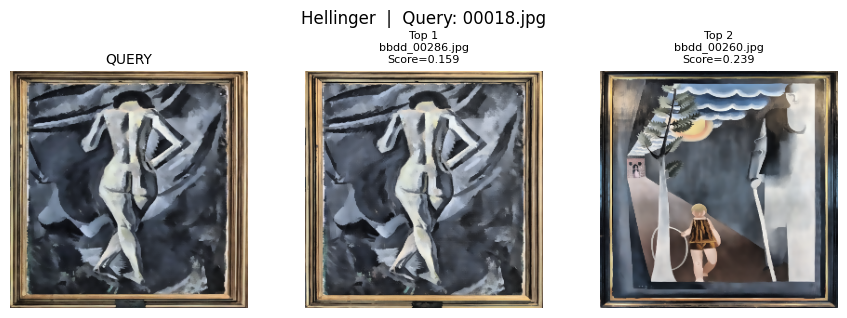


=== QUERY: 00019.jpg ===


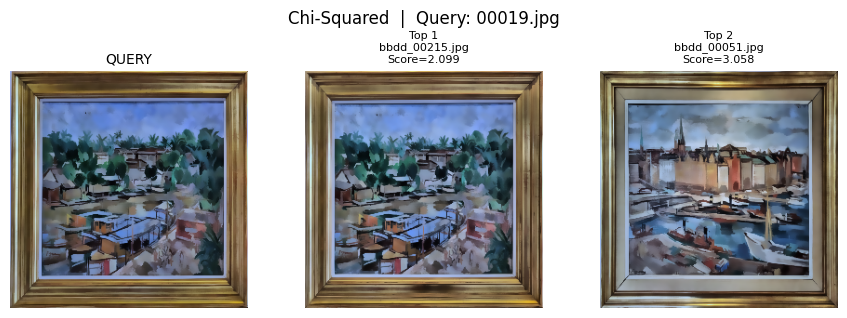

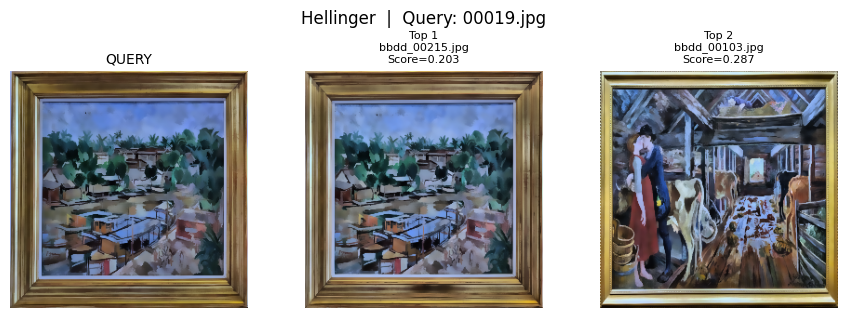


=== QUERY: 00020.jpg ===


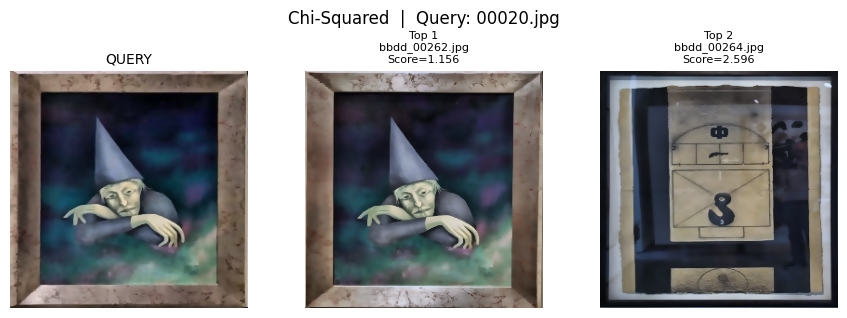

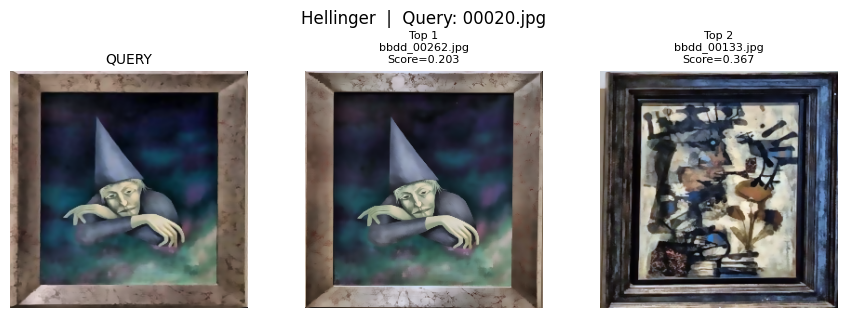


=== QUERY: 00021.jpg ===


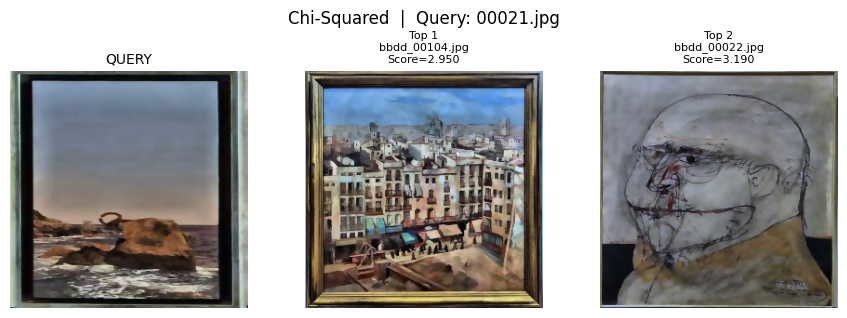

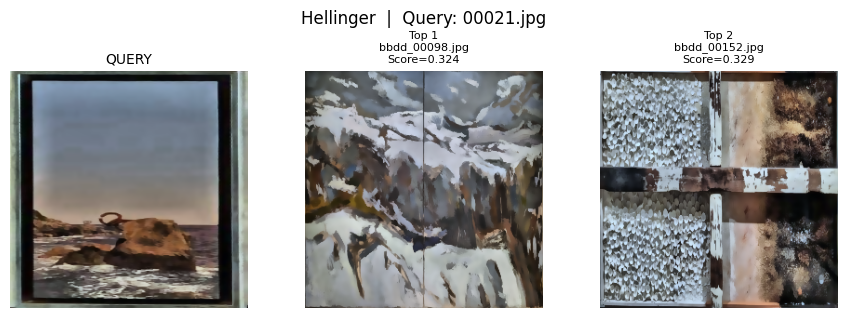


=== QUERY: 00022.jpg ===


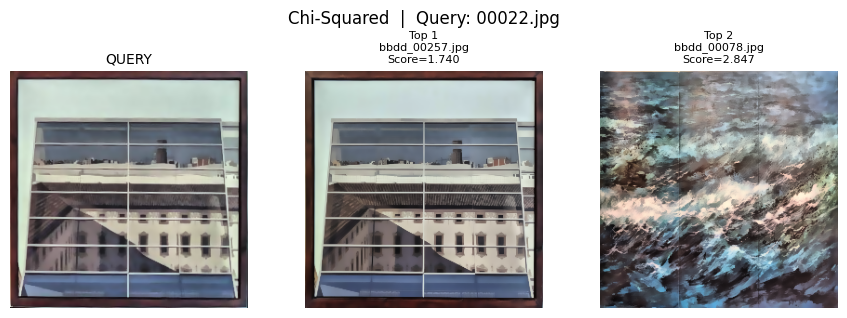

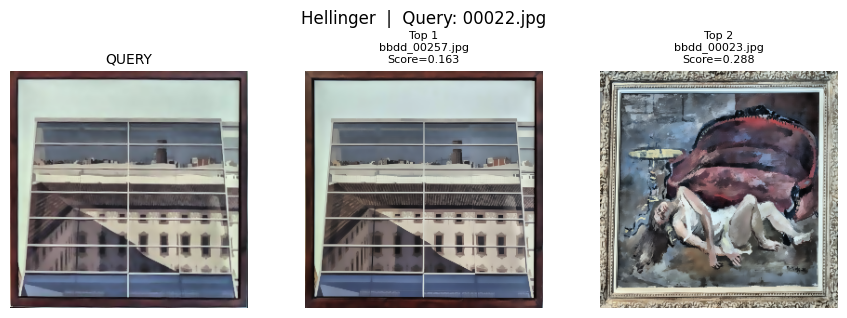


=== QUERY: 00023.jpg ===


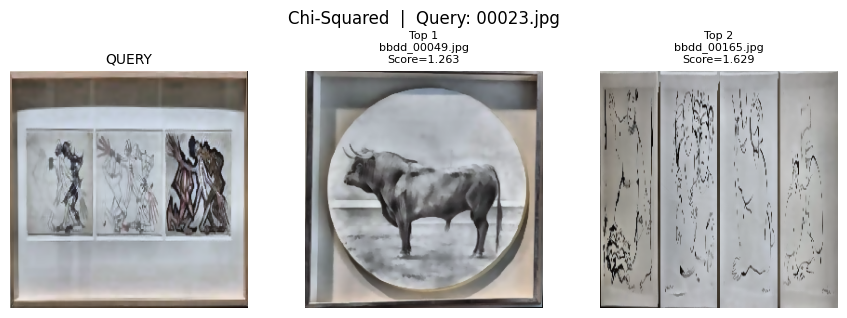

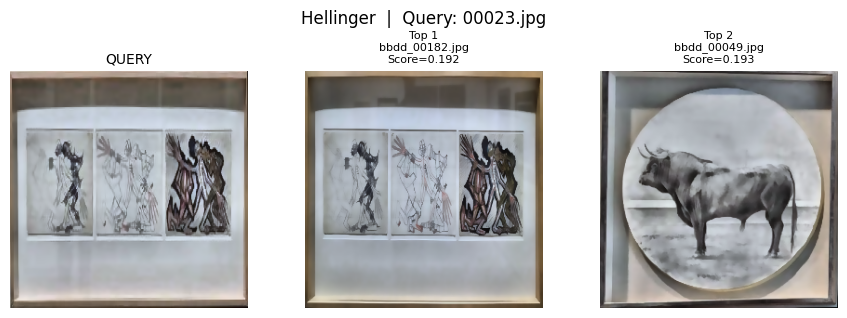


=== QUERY: 00024.jpg ===


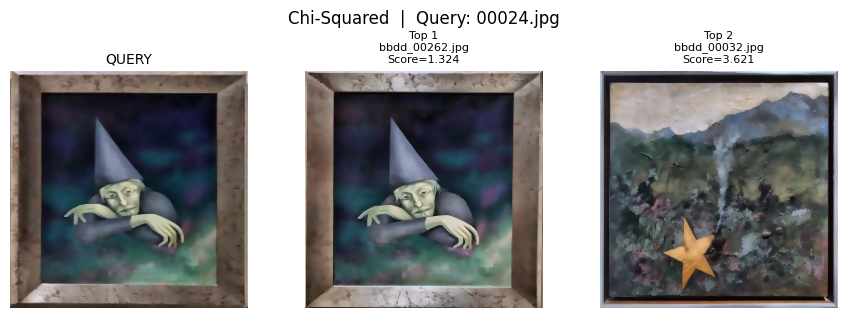

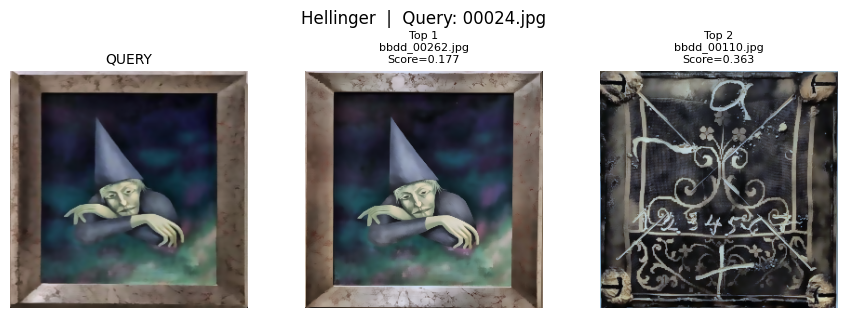


=== QUERY: 00025.jpg ===


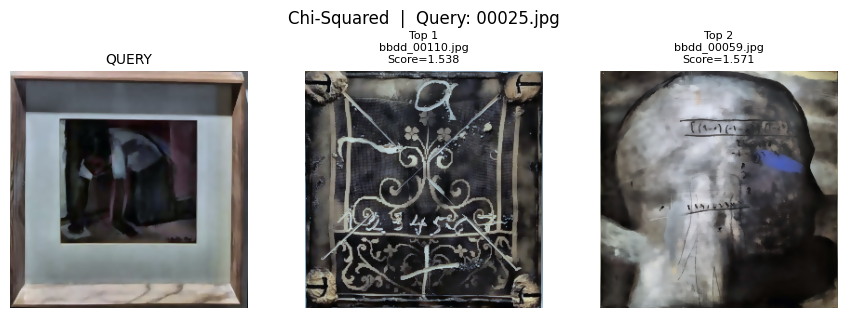

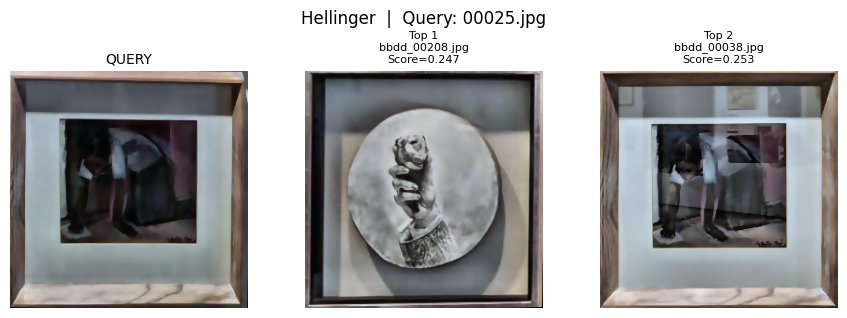


=== QUERY: 00026.jpg ===


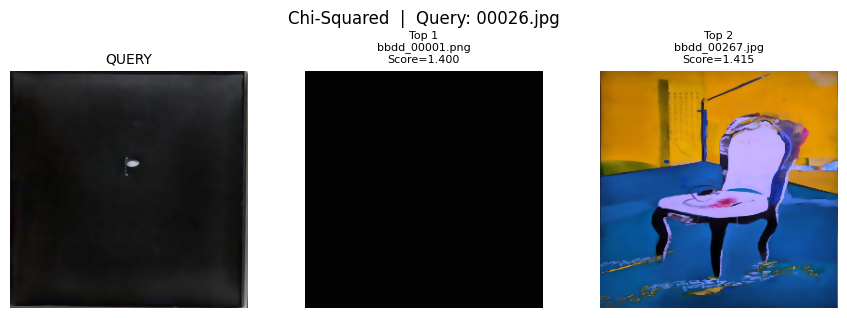

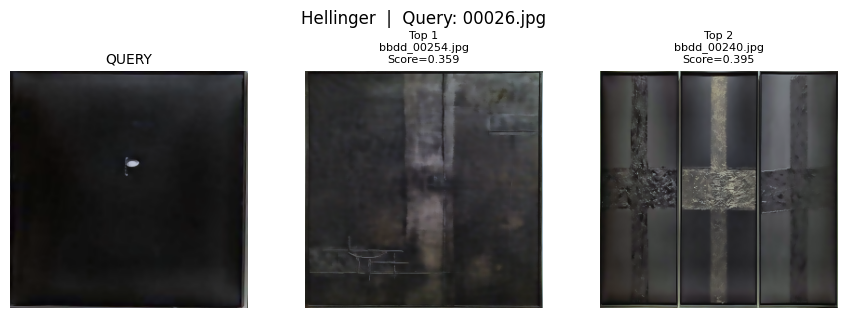


=== QUERY: 00027.jpg ===


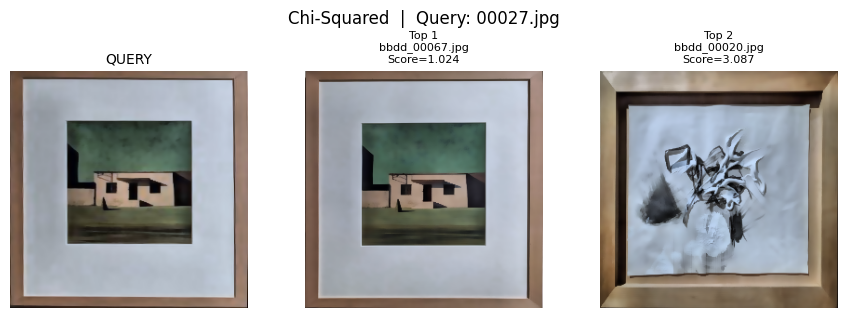

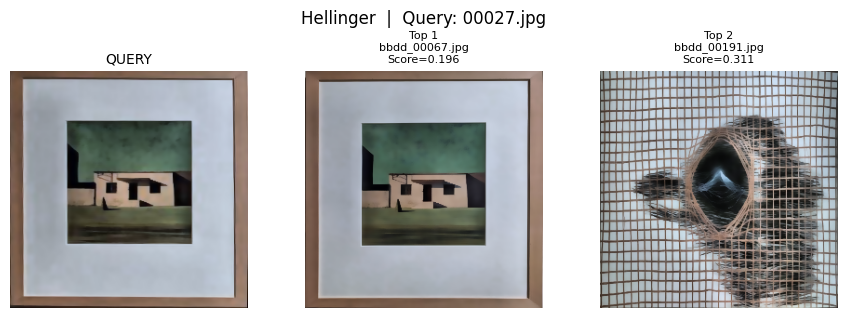


=== QUERY: 00028.jpg ===


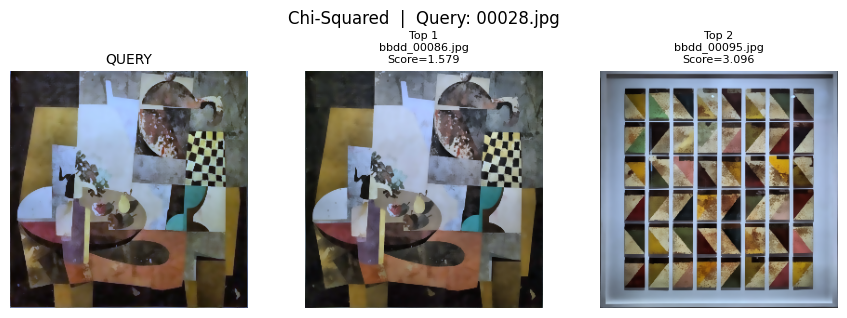

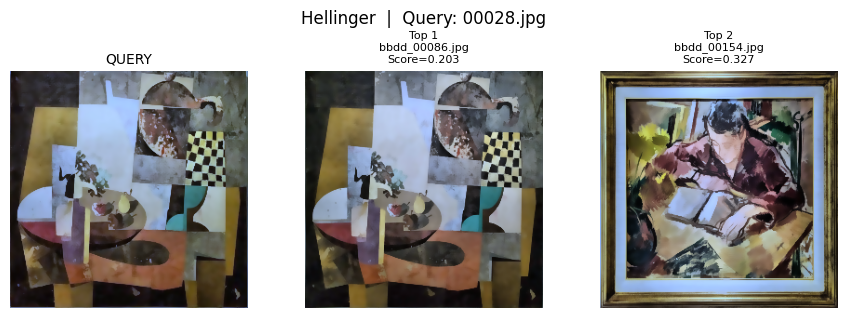


=== QUERY: 00029.jpg ===


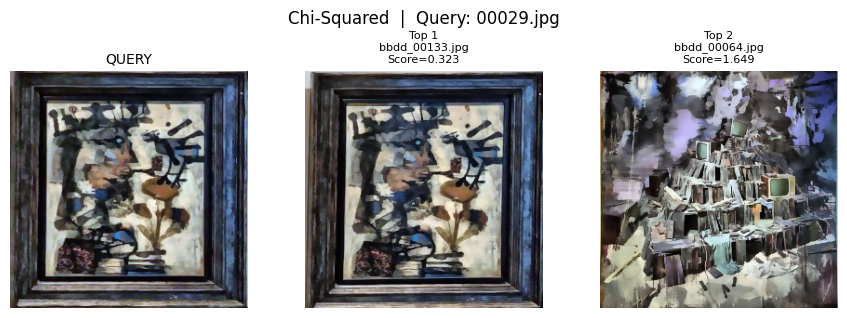

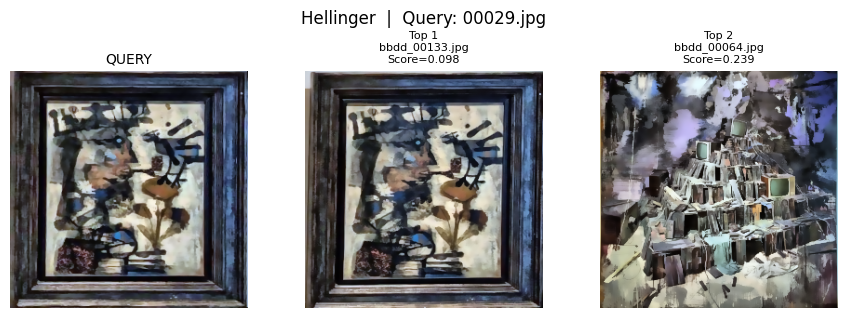

In [19]:
import glob
import cv2
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt  # <- important: pyplot

# === CONFIG ===
BBDD_DIR = Path("./descriptor/BBDD")
Q_DIR    = Path("./descriptor/qsd1_w1")
IMG_EXTS = ("*.jpg","*.jpeg","*.png","*.bmp","*.tif","*.tiff")
TOPK = 2

# --- PREPROCESSAMENT ROBUST ---
def preprocess(img_bgr):
    # 1) Resize coherent
    img = cv2.resize(img_bgr, (256, 256), interpolation=cv2.INTER_AREA)

    # 2) Gray-world white balance (balanceig simple de canals)
    img_f = img.astype(np.float32) + 1e-6
    mB, mG, mR = [img_f[:, :, c].mean() for c in range(3)]
    g = (mB + mG + mR) / 3.0
    img_f[:, :, 0] *= g / mB
    img_f[:, :, 1] *= g / mG
    img_f[:, :, 2] *= g / mR
    img_bal = np.clip(img_f, 0, 255).astype(np.uint8)

    # 3) CLAHE sobre el canal V (millora contrast/brillantor de forma estable)
    hsv = cv2.cvtColor(img_bal, cv2.COLOR_BGR2HSV)
    V = hsv[:, :, 2]
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    hsv[:, :, 2] = clahe.apply(V)
    img_clahe = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

    # 4) Suavitzat bilateral (treu soroll preservant vores i color)
    img_smooth = cv2.bilateralFilter(img_clahe, d=7, sigmaColor=60, sigmaSpace=7)

    return img_smooth  # BGR

# --- normalització L1 + arrel (Hellinger) per l'histograma 3D RGB ---
def rgb_hist_hellinger(img_bgr, bins=8):
    hist = cv2.calcHist([img_bgr], [0, 1, 2], None,
                        [bins, bins, bins], [0, 256, 0, 256, 0, 256]).astype(np.float32)
    s = hist.sum() + 1e-8
    hist /= s
    hist = np.sqrt(hist)  # Hellinger
    return hist.flatten().astype(np.float32)

# === INDEXA BBDD (sobre imatge preprocessada) ===
index = {}
images = {}

pathlist_bbdd = []
for ext in IMG_EXTS:
    pathlist_bbdd.extend(BBDD_DIR.glob(ext))
pathlist_bbdd = sorted(pathlist_bbdd)

for imagePath in pathlist_bbdd:
    filename = imagePath.name  # només el nom, sense directori
    image = cv2.imread(str(imagePath))
    if image is None:
        print(f"[WARN] No s'ha pogut llegir: {imagePath}")
        continue

    img_p = preprocess(image)  # <-- PREPROCESS APLICAT
    images[filename] = cv2.cvtColor(img_p, cv2.COLOR_BGR2RGB)  # per mostrar

    # histograma 3D RGB (8 bins per canal) + L1 + arrel
    hist = rgb_hist_hellinger(img_p, bins=8)
    index[filename] = hist

print(f"[INFO] Indexades {len(index)} imatges de la BBDD.")

# === Mètodes OpenCV per comparar histogrames ===
# (Amb aquests dos, valors més petits = millor)
OPENCV_METHODS = (
    ("Chi-Squared",  cv2.HISTCMP_CHISQR),
    ("Hellinger",    cv2.HISTCMP_BHATTACHARYYA),
)

# === Llista de queries ===
query_paths = []
for ext in IMG_EXTS:
    query_paths.extend(Q_DIR.glob(ext))
query_paths = sorted(query_paths)
print(f"[INFO] Trobades {len(query_paths)} queries a {Q_DIR}")

# === LOOP SOBRE CADA QUERY ===
for qpath in query_paths:
    qimg_bgr = cv2.imread(str(qpath))
    if qimg_bgr is None:
        print(f"[WARN] No s'ha pogut llegir query: {qpath}")
        continue

    qimg_p = preprocess(qimg_bgr)  # <-- PREPROCESS APLICAT A LA QUERY
    qimg_rgb = cv2.cvtColor(qimg_p, cv2.COLOR_BGR2RGB)

    # histograma de la query (coherent amb BBDD)
    qhist = rgb_hist_hellinger(qimg_p, bins=8)

    print(f"\n=== QUERY: {qpath.name} ===")

    # per a cada mètode, calculem distància i mostrem Top-K
    for (methodName, method) in OPENCV_METHODS:
        results = {}

        # Chi2/Hellinger: ordenar ascendent (menor = millor)
        for (k, hist) in index.items():
            d = cv2.compareHist(qhist, hist, method)
            results[k] = float(d)

        # ordena i selecciona Top-K (asc)
        results_sorted = sorted([(v, k) for (k, v) in results.items()])[:TOPK]

        # --- PLOT: Query + Top-K per aquest mètode ---
        cols = TOPK + 1
        fig = plt.figure(figsize=(3*cols, 3.2))
        fig.suptitle(f"{methodName}  |  Query: {qpath.name}", fontsize=12)

        # Col 0: query
        ax = fig.add_subplot(1, cols, 1)
        ax.imshow(qimg_rgb)
        ax.axis("off")
        ax.set_title("QUERY", fontsize=10)

        # Cols 1..TOPK: resultats
        for i, (score, fname) in enumerate(results_sorted, start=2):
            ax = fig.add_subplot(1, cols, i)
            ax.imshow(images[fname])  # ja en RGB
            ax.axis("off")
            ax.set_title(f"Top {i-1}\n{fname}\nScore={score:.3f}", fontsize=8)

        plt.tight_layout()
        plt.show()
